# **Visual Analysis & Comparison - Seville vs Malaga AIRBNB dataset** 🇪🇸

**Seville** and **Malaga** are two cities in the Andalucia Region in Spain,which they attract tourists from all over the world.

In this project, I will create a visual analysis of some **AIRBNB data** in these cities, comparing them and gaining some useful insights. 

This project was part of my Data Science Master Studies at University of Piraeus, Department of Informatics.

Dataset downloaded from [Inside Airbnb](http://insideairbnb.com/get-the-data/).

![](83227.jpg)

In [2]:
#At first, let's import the libraries that we will use.
import pandas as pd
import numpy as np
import folium
import matplotlib.pyplot as plt

#To ignore warnings
import warnings
warnings.filterwarnings('ignore')

# Seville

Let's start with the **listings.csv** , which contains a summary of the listings in **Seville**

In [3]:
listings = pd.read_csv('Seville/listings.csv')
listings.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,904994,"7. MAESTRANZA 2.(2Bedrooms,1sofabed,WIFI,balcony)",4813585,Francisco,Casco Antiguo,Arenal,37.38798,-5.99743,Entire home/apt,244,2,5,2017-07-03,0.04,22,213,0,A/SE/00112
1,726220,Apartment in the center of Seville,3757143,Jose Antonio,Casco Antiguo,San Vicente,37.39372,-6.00007,Entire home/apt,243,3,128,2022-08-18,1.03,1,275,2,VFT/SE/0390
2,32347,SevillaCenter,139939,Alejandro,Casco Antiguo,San Vicente,37.39358,-5.99975,Entire home/apt,99,2,168,2020-01-08,1.13,1,1,0,CTC-2018150852
3,905124,Apartment constitución III,4790497,Apartamentos Diaber - Book Seville,Casco Antiguo,Santa Cruz,37.38262,-5.99389,Entire home/apt,174,3,25,2023-02-21,0.27,32,285,13,A/SE/00141
4,49287,BEAUTIFUL APARTMENT IN SEVILLE,224697,Walter,Casco Antiguo,San Lorenzo,37.39898,-5.99533,Entire home/apt,136,3,42,2020-02-17,0.29,1,109,0,VFT/SE/01116


In [4]:
#Check the number of listings and features
print('Shape: ',listings.shape)
print(listings.columns)


Shape:  (7025, 18)
Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365', 'number_of_reviews_ltm', 'license'],
      dtype='object')


So we have **7025 listings** in Seville, which every listing has **18 features**. Let's brake these features down:

1. **id**: listing id 
2. **name**: name of the listing
3. **host_id**: the id of the host
4. **host_name**: name of the host
8. **neighbourhood_group**: the group of neighborhoods which the listing is located
9. **neighbourhood** : the specific neighbourhood of the listing
7. **latitude** : latitude
8. **longitude**: longitude
9. **room_type**: possible inputs: entire home/apt, private room, shared room,hotel room
10. **price**: daily price in local currenct (EUR)
11. **minimum_nights** : minimum nights required to book the place
12. **number_of_reviews**: how many reviews has every place
13. **last_review**: when was the last review
14. **reviews_per_month**: average reviews per month
15. **calculated_host_listings_count**: the number of listing the host has in the city/region.
16. **availability_365**: the availability of the listing for the next 365 days (How many of the next 365 are available to book)
17. **number_of_reviews_ltm**: the number of the reviews the listing has in the last 12 months
18. **license**: licence

In [5]:
#Let's change the input "Entire home/apt" to "Apartment" in the room_type column to have a more clear view of each room type

condition = listings['room_type'] == 'Entire home/apt'

listings.loc[condition, 'room_type'] = 'Apartment'

listings.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,904994,"7. MAESTRANZA 2.(2Bedrooms,1sofabed,WIFI,balcony)",4813585,Francisco,Casco Antiguo,Arenal,37.38798,-5.99743,Apartment,244,2,5,2017-07-03,0.04,22,213,0,A/SE/00112
1,726220,Apartment in the center of Seville,3757143,Jose Antonio,Casco Antiguo,San Vicente,37.39372,-6.00007,Apartment,243,3,128,2022-08-18,1.03,1,275,2,VFT/SE/0390
2,32347,SevillaCenter,139939,Alejandro,Casco Antiguo,San Vicente,37.39358,-5.99975,Apartment,99,2,168,2020-01-08,1.13,1,1,0,CTC-2018150852
3,905124,Apartment constitución III,4790497,Apartamentos Diaber - Book Seville,Casco Antiguo,Santa Cruz,37.38262,-5.99389,Apartment,174,3,25,2023-02-21,0.27,32,285,13,A/SE/00141
4,49287,BEAUTIFUL APARTMENT IN SEVILLE,224697,Walter,Casco Antiguo,San Lorenzo,37.39898,-5.99533,Apartment,136,3,42,2020-02-17,0.29,1,109,0,VFT/SE/01116


In [6]:
#Let's check for null values
listings.isna().sum()

id                                  0
name                                0
host_id                             0
host_name                           0
neighbourhood_group                 0
neighbourhood                       0
latitude                            0
longitude                           0
room_type                           0
price                               0
minimum_nights                      0
number_of_reviews                   0
last_review                       926
reviews_per_month                 926
calculated_host_listings_count      0
availability_365                    0
number_of_reviews_ltm               0
license                            76
dtype: int64

In [7]:
#There are no empty columns and rows, but we have some nulls so we just drop them

listings = listings.dropna()
listings.isna().sum()



id                                0
name                              0
host_id                           0
host_name                         0
neighbourhood_group               0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
last_review                       0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
number_of_reviews_ltm             0
license                           0
dtype: int64

Let's now plot those listings clustered on the map using folium plugins.

In [8]:
from folium import plugins

sevilla_coords = [37.392529,-5.994072]
map = folium.Map(location=sevilla_coords, zoom_start=12)
clusters = plugins.MarkerCluster().add_to(map)

for lat,lng,name,price in zip(listings.latitude, listings.longitude, listings.name,listings.price):
    folium.Marker(
        location= [lat,lng],
        popup= (name,price),
         icon=folium.Icon(color='darkred', icon="fa-home", prefix='fa')
    ).add_to(clusters)

map 

Let's import the **neighbourhoods.csv** and the **neighbourhoods.geojson** to visualize a Choropleth.

In [9]:
hoods = 'Seville/neighbourhoods.geojson'

Count the listings that exist in every neighborhood and visualise it on the map.

In [10]:
hoodcounts = listings['neighbourhood'].value_counts()
hoodcounts = hoodcounts.reset_index()
hoodcounts.columns = ['neighbourhood', 'count']
hoodcounts

,neighbourhood,count
0,Alfalfa,665
1,Santa Cruz,542
2,Arenal,477
3,San Bartolomé,461
4,Feria,443
...,...,...
97,La Corza,1
98,Las Almenas,1
99,Zodiaco,1
100,La Barzola,1


In [11]:
sevilla_map = folium.Map(location=sevilla_coords, zoom_start=14)

folium.Choropleth(
    geo_data=hoods,
    data=hoodcounts,
    columns=['neighbourhood', 'count'],
    key_on='feature.properties.neighbourhood',
    bins=20, 
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Number of AIRBNBs',
    line_color="#0000",
    show=True,
    overlay=True,
    nan_fill_color = "White"
).add_to(sevilla_map)

sevilla_map

**It is clear that most of the listings are near 'Casco Antiguo' which is the tourist center.** Let's check the mean prices in every neighbourhood.

It is time to create a histogram to check the price range for a night in a Seville

In [12]:
counts, bin_ranges_sev = np.histogram(listings['price'])
print(counts)
print(bin_ranges_sev) 

[6031   18    5    0    1    0    0    0    0    3]
[9.00000e+00 4.14550e+03 8.28200e+03 1.24185e+04 1.65550e+04 2.06915e+04
 2.48280e+04 2.89645e+04 3.31010e+04 3.72375e+04 4.13740e+04]


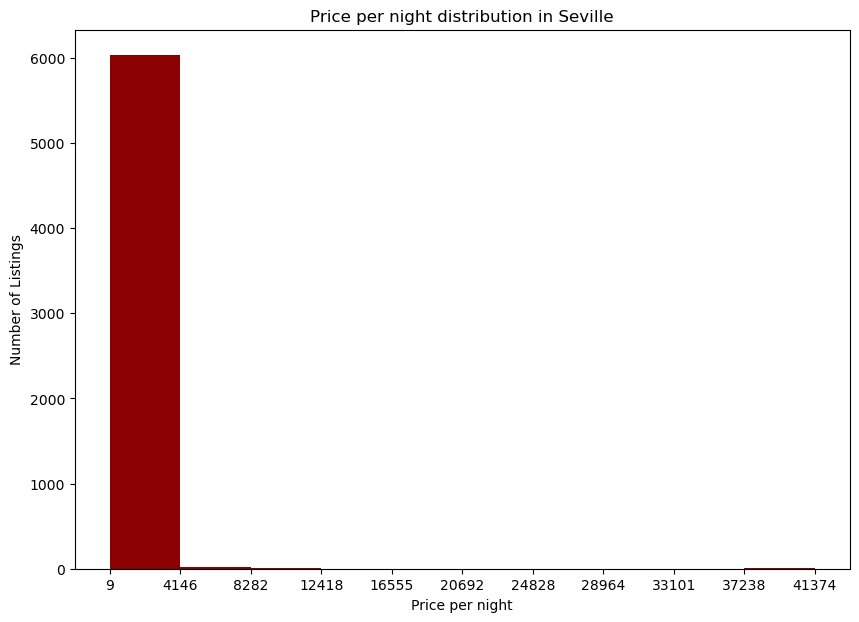

In [13]:
listings['price'].plot(kind = 'hist', figsize=(10,7), xticks=bin_ranges_sev, color = 'darkred')
plt.title('Price per night distribution in Seville')
plt.ylabel('Number of Listings')
plt.xlabel('Price per night')
plt.show()


We can understand that there are some outliers in the dataset which are spoiling the result. More specific, we will  only plot rooms up to 1000 EUR.

[1392 2662 1130  379  165  100   38   22   21   44]
[  9. 108. 207. 306. 405. 504. 603. 702. 801. 900. 999.]


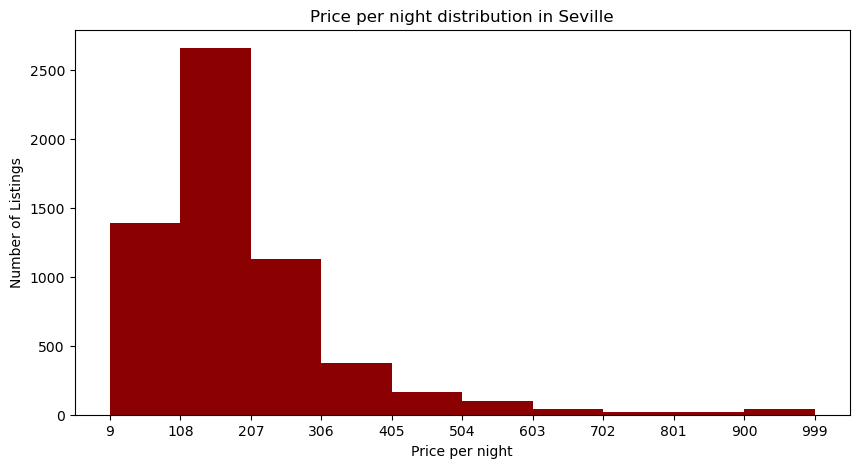

In [14]:
condition = listings['price'] < 1000
lowlistings = listings[condition]

counts, bin_ranges_sev = np.histogram(lowlistings['price'])
print(counts)
print(bin_ranges_sev) 

lowlistings['price'].plot(kind = 'hist', figsize=(10,5), xticks=bin_ranges_sev, color = 'darkred')

plt.title('Price per night distribution in Seville')
plt.ylabel('Number of Listings')
plt.xlabel('Price per night')
plt.show()

So, most of the homes to rent in Seville are within a range of **9 and 306 EUR** per night, especially in the range between **108 and 207 EUR** where there are about **2500 rooms** (~1/3 of all listings)

Let's plot these prices on the map, without the outliers.

In [15]:
hoodprices = lowlistings.groupby('neighbourhood')['price'].mean()

In [16]:
sevilla_map = folium.Map(location=sevilla_coords, zoom_start=13)

folium.Choropleth(
    geo_data=hoods,
    data=hoodprices,
    columns=['neighbourhood', 'count'],
    key_on='feature.properties.neighbourhood',
    bins=20, 
    fill_color='Greens',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Mean Prices per Night',
    line_color="#0000",
    show=True,
    overlay=True,
    nan_fill_color = "White"
).add_to(sevilla_map)

sevilla_map

It is very intresting that we see that the  **higher prices** are  **in souther city center**,especially near the  **'Distrito Sur'** Neighbourhood and in the **airport area**! Also, there is a negihbourhood called **'Los Principes-La Fontanilla'** at the **North** which has **high prices**. To find the **cheapest** AIRBNBs people should rent to the **North-East of the City Center**.

Let's now see the number of each room type listings.

In [17]:
roomtype_counts = listings.groupby('room_type').size()
roomtype_counts

room_type
Apartment       5130
Hotel room        33
Private room     872
Shared room       23
dtype: int64

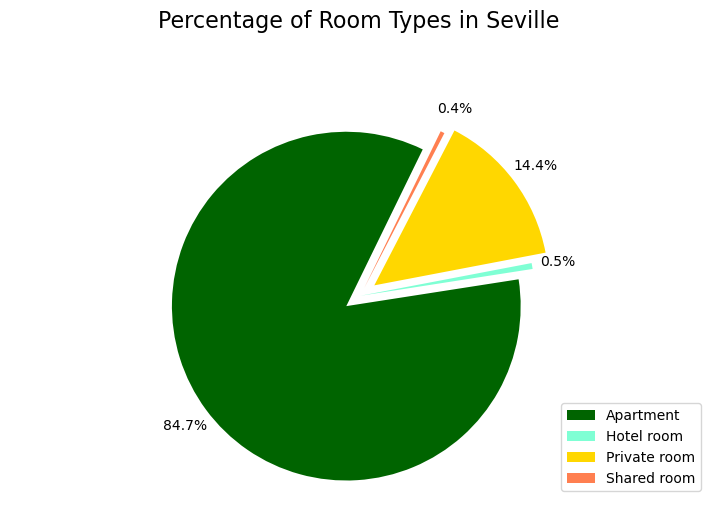

In [18]:
explode = [0.1, 0, 0.1, 0.05]
colors = ['darkgreen','aquamarine','gold','coral']
roomtype_counts.plot(
    kind= 'pie',
    figsize=(9, 5),
    autopct='%1.1f%%',
    startangle=64,
    labels = None,
    pctdistance=1.15,
    explode = explode,
    colors = colors
)
plt.title('Percentage of Room Types in Seville', y=1.2, fontsize= 16)

plt.axis('equal') 

plt.ylabel("")

plt.legend(labels = roomtype_counts.index, loc='lower right' )

plt.show()

It is clear that the most of the listings are apartments. It would be nice to check if there are any price and review per month differences in the median and mean of every category

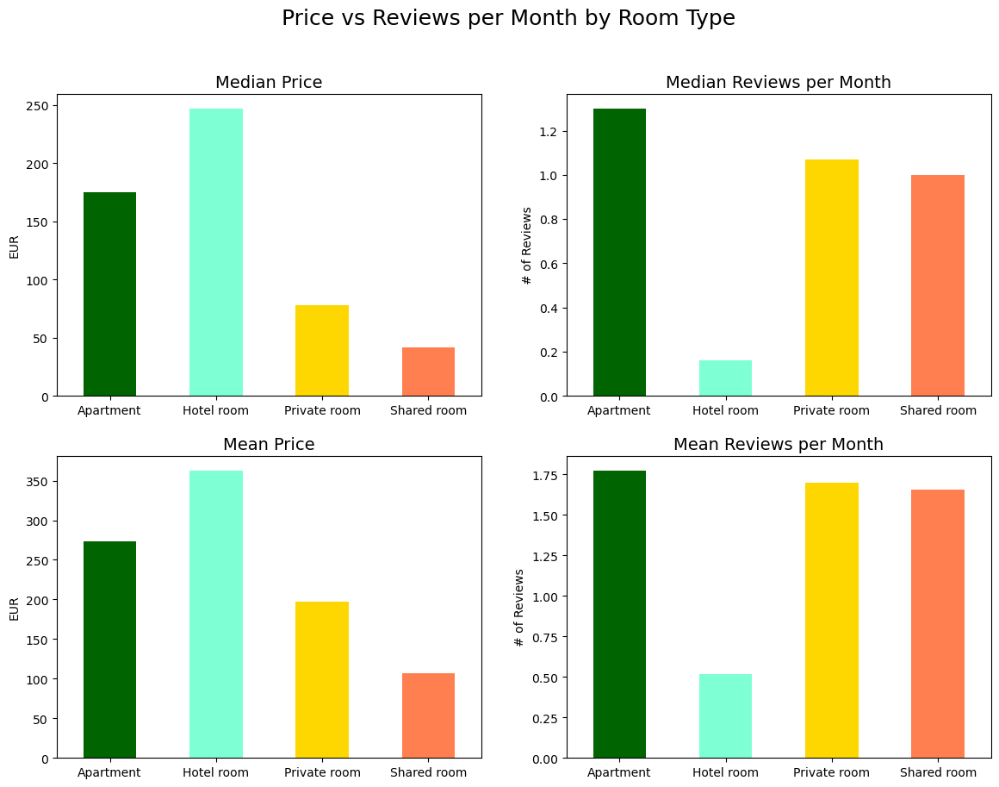

In [19]:
fig,axes = plt.subplots(2, 2, figsize=(14, 10))
fig.suptitle('Price vs Reviews per Month by Room Type', fontsize= 18)


#Let's create a variable to save the median of every room type
roomtype_medians = listings.groupby('room_type').median()

#And create 1 barplot to plot the median prices
roomtype_medians['price'].plot(kind= 'bar',color = colors,rot= 0,ax=axes[0,0])
axes[0,0].set_title('Median Price', fontsize= 14)
axes[0,0].set_xlabel(None)
axes[0,0].set_ylabel('EUR')

#Create a barplot, to plot the median number of reviews
roomtype_medians['reviews_per_month'].plot(kind= 'bar',color = colors,rot= 0,ax=axes[0,1])
axes[0,1].set_title('Median Reviews per Month', fontsize= 14)
axes[0,1].set_xlabel(None)
axes[0,1].set_ylabel('# of Reviews')

#Create a variable to save the mean of every room type
roomtype_means = listings.groupby('room_type').mean()

#Create a barplot to plot the mean prices
roomtype_means['price'].plot(kind= 'bar',color = colors,rot= 0,ax=axes[1,0])
axes[1,0].set_title('Mean Price', fontsize= 14)
axes[1,0].set_xlabel(None)
axes[1,0].set_ylabel('EUR')

#Lastly, create a barplot to plot the mean number of reviews
roomtype_means['reviews_per_month'].plot(kind= 'bar',color = colors,rot= 0,ax=axes[1,1])
axes[1,1].set_title('Mean Reviews per Month', fontsize= 14)
axes[1,1].set_xlabel(None)
axes[1,1].set_ylabel('# of Reviews')
plt.show()

Let's brake down the plots:

**1.** **Hotel rooms** in Seville are by far **the most expensive**.

**2.** The average monthly reviews for **Apartments, Private Rooms and Shared Rooms** are very close. This indicates that customers tend to review **less the hotel rooms than the shared rooms** even though there are pretty much the same number of them listed. Hotel rooms don't get as much attraction as the other categories.

**3** Even though the prices differ between Apartment, Private Room and Shared Room, they tend to get very close numbers on monthly reviews.

Let's check if there is correlation between price and reviews per month on the listings without the very expensive ones.

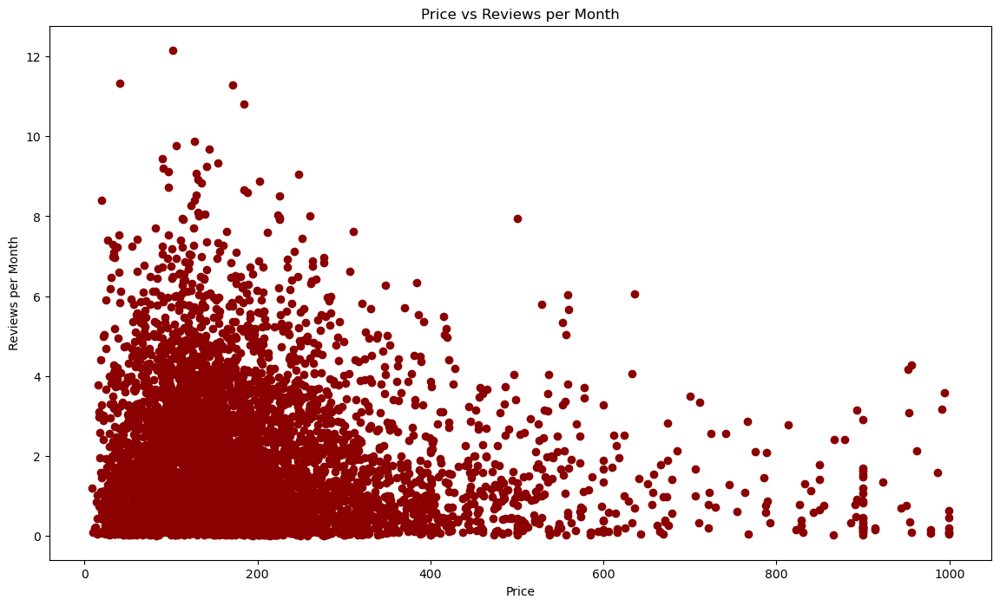

In [20]:
plt.figure(figsize=(14,8))
plt.scatter(x= lowlistings['price'], y = lowlistings['reviews_per_month'],color = 'darkred')
plt.title('Price vs Reviews per Month')
plt.xlabel('Price')
plt.ylabel('Reviews per Month')
plt.show()

It seems that there is correlation between those values. **As price reduces, it is more likely for the room to have more reviews per month.** That could explain why hotel rooms have very low number of monthly reviews.

Lastly, let's find out **the 100 most famous room listings (Apartment or Private rooms) by reviews per month**,as soon as the apartments and the private rooms are about the 99% of the whole listings.

In [21]:
condition = (listings['room_type'] == 'Apartment') | (listings['room_type'] == 'Private rooms')

top100 = listings[condition].sort_values(by=['reviews_per_month'],ascending= False).head(100)
top100.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
6477,775379708444113341,Apto Entrepuentes Triana / Los Remedios,490352688,Francisco,Triana,Triana Este,37.379755,-5.999967,Apartment,102,1,45,2023-03-30,12.16,1,146,45,VFT/SE/10109
562,8928663,Loft en el corazón de Sevilla,46687944,Nacho,Casco Antiguo,Arenal,37.385120,-5.996760,Apartment,171,1,1011,2023-03-27,11.29,1,87,108,VFT-SE-00401
5052,563716209405543880,Moderno apartamento en pleno centro de Sevilla,60960591,Carla,Casco Antiguo,Museo,37.388240,-6.001210,Apartment,184,1,146,2023-03-28,10.81,1,310,139,VFT/SE/09131
6383,797613624706025775,Enjoy this quiet and centric apartment,4421289,Maria,Casco Antiguo,San Lorenzo,37.398658,-5.995383,Apartment,127,1,25,2023-03-25,9.87,1,102,25,VFT/SE/04116
4832,53877073,The Lemon Tree Corner,241206804,Cesar,San Pablo - Santa Justa,San José Obrero,37.396606,-5.975960,Apartment,106,1,152,2023-03-20,9.76,1,174,123,VFT/SE/08921


And plot these apartments on the Seville Map.

In [22]:
map = folium.Map(location=sevilla_coords, zoom_start=12)
apartments = folium.map.FeatureGroup()

for lat,lng,name,price in zip(top100.latitude, top100.longitude, top100.name,top100.price):
    folium.Marker(
        location= [lat,lng],
        popup= (name,price),
         icon=folium.Icon(color='red', icon="fa-home", prefix='fa')
    ).add_to(apartments)


map.add_child(apartments)

**It is clear that the most of the 100 most famous rooms by reviews per month are located very close to the city center, as we expected tourists book and rate more these listings.**

In [23]:
#set as index the 'id' column
top100.set_index('id', inplace= True)

In [24]:
top100

,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
id,,,,,,,,,,,,,,,,,
775379708444113341,Apto Entrepuentes Triana / Los Remedios,490352688,Francisco,Triana,Triana Este,37.379755,-5.999967,Apartment,102,1,45,2023-03-30,12.16,1,146,45,VFT/SE/10109
8928663,Loft en el corazón de Sevilla,46687944,Nacho,Casco Antiguo,Arenal,37.385120,-5.996760,Apartment,171,1,1011,2023-03-27,11.29,1,87,108,VFT-SE-00401
563716209405543880,Moderno apartamento en pleno centro de Sevilla,60960591,Carla,Casco Antiguo,Museo,37.388240,-6.001210,Apartment,184,1,146,2023-03-28,10.81,1,310,139,VFT/SE/09131
797613624706025775,Enjoy this quiet and centric apartment,4421289,Maria,Casco Antiguo,San Lorenzo,37.398658,-5.995383,Apartment,127,1,25,2023-03-25,9.87,1,102,25,VFT/SE/04116
53877073,The Lemon Tree Corner,241206804,Cesar,San Pablo - Santa Justa,San José Obrero,37.396606,-5.975960,Apartment,106,1,152,2023-03-20,9.76,1,174,123,VFT/SE/08921
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29924094,"Apartment with amazing views to ""Las Setas""",107664696,Marta Del Rocio,Casco Antiguo,"Encarnación, Regina",37.393520,-5.992450,Apartment,184,2,333,2023-03-27,6.27,2,271,86,VFT/SE/04611
593914837043726325,"Luminoso y acogedor loft, excelente ubicación.",132326094,Jose Antonio,Triana,Triana Este,37.380238,-5.999997,Apartment,133,1,74,2023-03-20,6.24,3,61,74,VFT/SE/08893
772926540626735664,Triana Luxury Suites VI - 2 Bedrooms 2 bathrooms,14958822,Nacho,Triana,Triana Casco Antiguo,37.383870,-6.003920,Apartment,224,2,18,2023-03-26,6.21,147,51,18,A/SE/00408


Let's continue by loading the **calendar.csv**  for Seville.

In [25]:
calendar = pd.read_csv('Seville/calendar.csv')
calendar

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights
0,32347,2023-03-31,f,$99.00,$99.00,2,1125
1,32347,2023-04-01,f,$99.00,$99.00,2,1125
2,32347,2023-04-02,f,$99.00,$99.00,2,1125
3,32347,2023-04-03,f,$99.00,$99.00,2,1125
4,32347,2023-04-04,f,$99.00,$99.00,2,1125
...,...,...,...,...,...,...,...
2563755,725287,2024-03-25,f,$35.00,$35.00,2,1125
2563756,725287,2024-03-26,f,$35.00,$35.00,2,1125
2563757,725287,2024-03-27,f,$35.00,$35.00,2,1125
2563758,725287,2024-03-28,f,$35.00,$35.00,2,1125


In [26]:
calendar.dtypes

listing_id         int64
date              object
available         object
price             object
adjusted_price    object
minimum_nights     int64
maximum_nights     int64
dtype: object

We have to change the data types to the right ones.

In [27]:
calendar['date'] = pd.to_datetime(calendar['date']) #date to datetime
calendar['available'] = calendar['available'].replace({'f': False, 't': True})
calendar['price'] = calendar['price'].str.replace('$','').str.replace(',', '').astype(str)
calendar['price'] = calendar['price'].astype(float)
calendar['adjusted_price'] = calendar['adjusted_price'].str.replace('$','').str.replace(',', '').astype(str)
calendar['adjusted_price'] = calendar['adjusted_price'].astype(float)
calendar.dtypes

listing_id                 int64
date              datetime64[ns]
available                   bool
price                    float64
adjusted_price           float64
minimum_nights             int64
maximum_nights             int64
dtype: object

This calendar provides all the information for the next 365 days **(2023-03-31-2024-03-29)** for the listings. We will keep only the 100 most reviewed listings as we found them before and try to analyze the means of them.

In [28]:

condition = calendar['listing_id'].isin(top100.index)
cal_top100 = calendar[condition]

mean_prices_sev = cal_top100.groupby('date')['price'].mean()


Now let's set as index the dates to have a nice time series

Let's check how the price changes through time for these top 5 apartments.

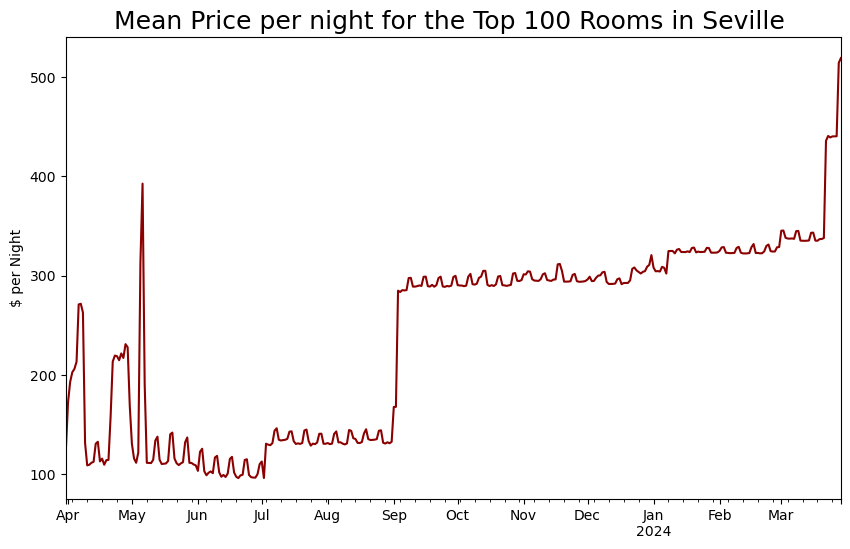

In [29]:
plt.figure(figsize=(10,6))

mean_prices_sev.plot(color = 'darkred')

plt.title('Mean Price per night for the Top 100 Rooms in Seville ', fontsize = 18)
plt.xlabel(None)
plt.ylabel('$ per Night')

plt.show()

1. In the **near future there is high variance**.
2. The average prices tend to go **higher from September and after**.
3. The **best prices** are **late June - early July**.
4. There is **seasonality** on the price. The **highs** happen **4 to 5 times a month** or **once a week**, so the seasonality must coming from the **weekends**.

Let's now check how the availability behaves over time.

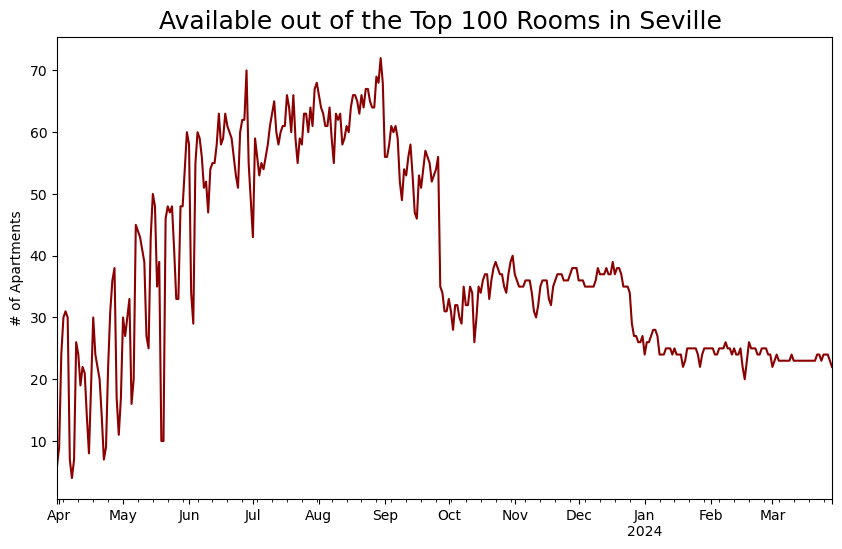

In [30]:
availables_sev = cal_top100.groupby('date')['available'].sum()

plt.figure(figsize=(10,6))

availables_sev.plot(color = 'darkred')
plt.title('Available out of the Top 100 Rooms in Seville ', fontsize = 18)
plt.xlabel(None)
plt.ylabel('# of Apartments')
plt.show()

Let's break down this plot:

1. There is an **upward trend** from **April to September**. This is normal, due to the fact that the closer the dates are to the present, the harder is to find an available room.
2. From **September to March 2024** there are **2 big drops** on the chart, one near October and one near January 2024. This could probably happen due to the fact that some hosts are deciding to **block it from bookings**, because after those drops the number of availables **never recovers**.


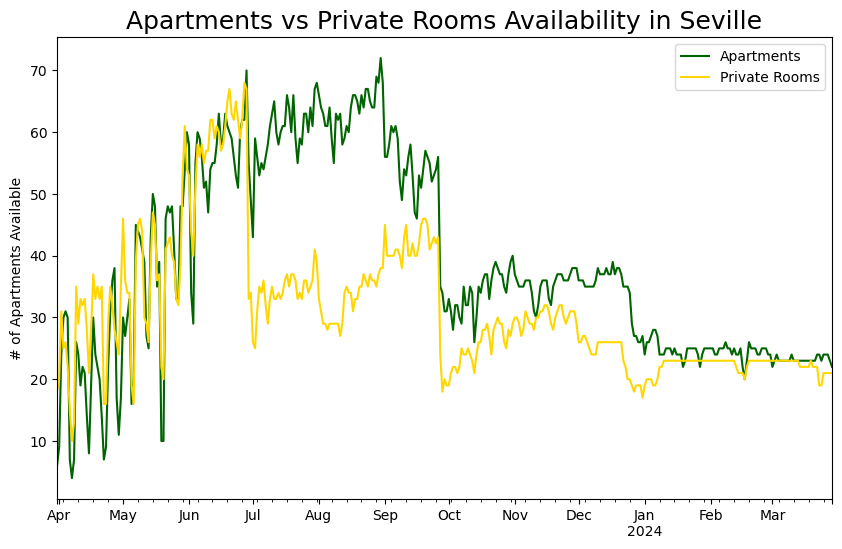

In [31]:
#Top 100 Apartments :
condition = listings['room_type'] == 'Apartment'
apart100_sev = listings[condition].sort_values(by=['reviews_per_month'],ascending= False).head(100)
apart100_sev.set_index('id', inplace= True)

#Top 100 Private Rooms:
condition = listings['room_type'] == 'Private room'
prive100_sev = listings[condition].sort_values(by=['reviews_per_month'],ascending= False).head(100)
prive100_sev.set_index('id', inplace= True)

#Calendar of Top 100 Apartments:
condition = calendar['listing_id'].isin(apart100_sev.index)
cal_apart100_sev = calendar[condition]

#Calendar of Top 100 Private Rooms:
condition = calendar['listing_id'].isin(prive100_sev.index)
cal_prive100_sev = calendar[condition]

#Sum of every category

availables_apart_sev = cal_apart100_sev.groupby('date')['available'].sum()
availables_prive_sev = cal_prive100_sev.groupby('date')['available'].sum()
plt.figure(figsize=(10,6))

#Plot
availables_apart_sev.plot(color = 'darkgreen')
availables_prive_sev.plot(color = 'gold')
plt.title('Apartments vs Private Rooms Availability in Seville', fontsize = 18)
plt.xlabel(None)
plt.ylabel('# of Apartments Available')
plt.legend(labels = ['Apartments','Private Rooms'])
plt.show()


1. **Apartments** have an **upward trend until September**. **Private rooms'** upward trend ends in **Late June**.
2. **Private Rooms**' availability** drops hard** in **late June and late September** and never recovers. 
3. **Both Room Types** have the same **3 big drops**, with the last 2 for both **never recovering**. This means that  **twice, a big number of rooms are withdrawn from the market in the same time.**


Now we will use a **scatter plot** to check the relationship between availabilty and price for the top 100 apartments.

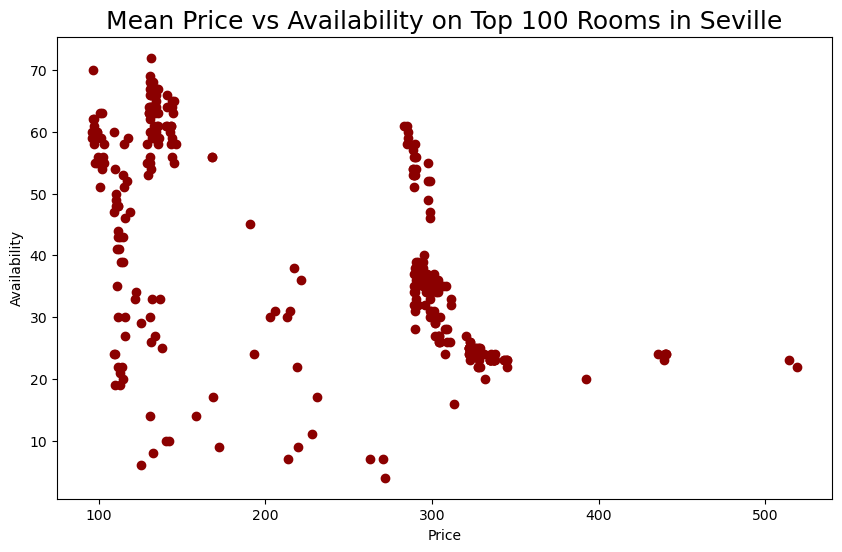

In [32]:
plt.figure(figsize=(10,6))
plt.scatter(mean_prices_sev.values, availables_sev.values, color = 'darkred')
plt.title('Mean Price vs Availability on Top 100 Rooms in Seville', fontsize = 18)
plt.xlabel('Price')
plt.ylabel('Availability')
plt.show()


Let's try to fit a straight line to have something more clear.

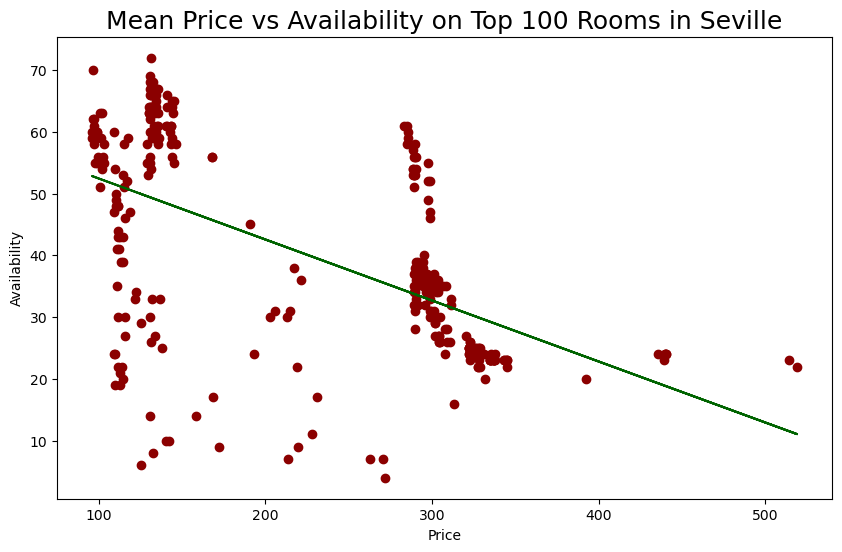

In [33]:
from numpy.polynomial import Polynomial

x = mean_prices_sev.values
y = availables_sev.values
polynomial = Polynomial.fit(x, y, deg=1)
plt.figure(figsize=(10,6))
plt.scatter(mean_prices_sev.values, availables_sev.values, color = 'darkred')
plt.title('Mean Price vs Availability on Top 100 Rooms in Seville', fontsize = 18)
plt.xlabel('Price')
plt.ylabel('Availability')
plt.plot(x, polynomial(x), color='darkgreen')


plt.show()

It seems that we have **a bit of inverse correlation between those 2 values**, which seems logical because the more available rooms to book,the higher the supply becomes, so the price goes down.The fact that the plot is not so clear indicates that maybe there are some other external factors that could affect the price.

The last thing we will do for Seville is to check if these top 100 AIRBNBs belong to 'big players' of the market by checking how many listings does each one of these hosts have.

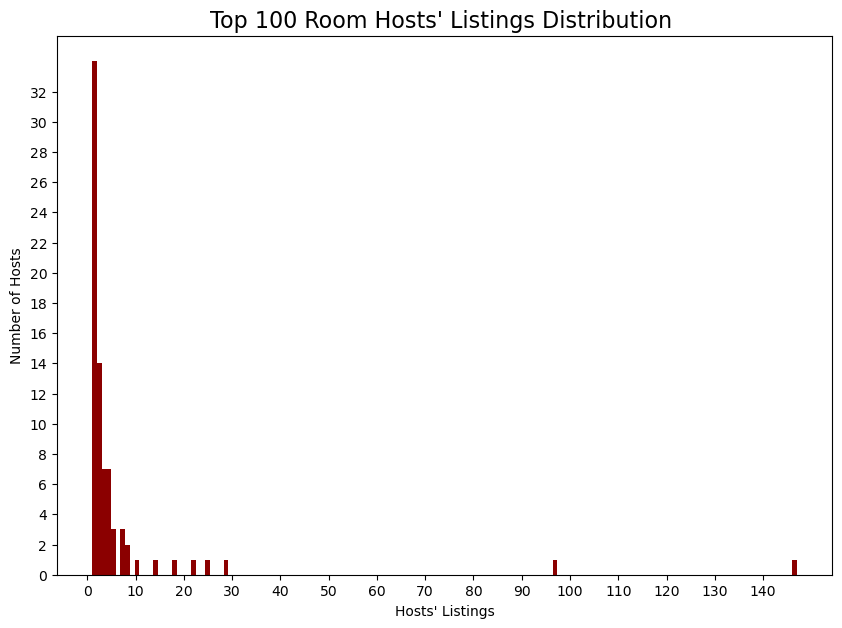

In [34]:
top100.groupby('host_id')['calculated_host_listings_count'].mean().plot(kind = 'hist', figsize=(10,7), color = 'darkred', bins = 150,xticks= range(0,150,10),yticks=range(0,34,2))
plt.title("Top 100 Room Hosts' Listings Distribution ", fontsize = 16)
plt.ylabel('Number of Hosts')
plt.xlabel("Hosts' Listings")
plt.show()

So we can see that most of these **top 100 rooms' hosts own under 5 listings** in AIRBNB, which is nice to see that this economy is **not centralized** to a few owners.

# Malaga

It is time to move on Malaga Dataset. We will start by loading the **listings.csv**.

In [35]:
listings_mal = pd.read_csv('Malaga/listings.csv')
listings_mal.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,96033,"* Cosy flat 200m from the beach, El Palo/Malaga *",510467,Rafael,NaN,Este,36.720310,-4.356270,Entire home/apt,60,3,171,2023-03-14,1.49,1,232,39,VFT/MA/22043
1,166473,Perfect Location In Malaga,793360,Fred,NaN,Este,36.719340,-4.359420,Private room,24,5,88,2022-12-17,0.62,4,244,11,CTC/2018118027
2,212845,BEAUTIFUL DOUBLE ROOM IN MALAGA,617998,Valle,NaN,Este,36.726060,-4.365410,Shared room,39,2,42,2023-02-27,0.31,2,224,6,VFT/MA/09354
3,330760,Malaga Lodge Guesthouse Double room-shared bath.,1687526,Mayte,NaN,Centro,36.729786,-4.413462,Private room,65,1,49,2023-01-17,0.36,3,205,2,VFT/MA/12240
4,340024,NEW APARTMENT IN MALAGA CENTER,1725690,Carlos,NaN,Centro,36.728130,-4.414220,Entire home/apt,65,3,211,2023-02-27,1.73,1,269,40,VFT/MA/02334


Let's make the same data preproccessing operations.

In [36]:
condition = listings_mal['room_type'] == 'Entire home/apt'
listings_mal.loc[condition, 'room_type'] = 'Apartment'


In [37]:
listings_mal['neighbourhood_group'].isna().sum()

7534

In [38]:
#drop the whole neighbourhood_group column because there are not any values on that.
listings_mal.drop(['neighbourhood_group'], axis=1, inplace= True)
listings_mal

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,96033,"* Cosy flat 200m from the beach, El Palo/Malaga *",510467,Rafael,Este,36.720310,-4.356270,Apartment,60,3,171,2023-03-14,1.49,1,232,39,VFT/MA/22043
1,166473,Perfect Location In Malaga,793360,Fred,Este,36.719340,-4.359420,Private room,24,5,88,2022-12-17,0.62,4,244,11,CTC/2018118027
2,212845,BEAUTIFUL DOUBLE ROOM IN MALAGA,617998,Valle,Este,36.726060,-4.365410,Shared room,39,2,42,2023-02-27,0.31,2,224,6,VFT/MA/09354
3,330760,Malaga Lodge Guesthouse Double room-shared bath.,1687526,Mayte,Centro,36.729786,-4.413462,Private room,65,1,49,2023-01-17,0.36,3,205,2,VFT/MA/12240
4,340024,NEW APARTMENT IN MALAGA CENTER,1725690,Carlos,Centro,36.728130,-4.414220,Apartment,65,3,211,2023-02-27,1.73,1,269,40,VFT/MA/02334
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7529,858466197822665030,Holidays2Malaga Paseo los Tilos 3 bed,115528688,Luis Carlos,Cruz De Humilladero,36.712685,-4.436662,Apartment,180,1,0,NaN,NaN,96,362,0,VFT/MA/62812
7530,858501303932825096,Piso Centro Ciudad,111975119,Arianna,Centro,36.723100,-4.419910,Apartment,400,1,0,NaN,NaN,1,365,0,Exempt
7531,858583702392267556,Loft El Palo,507770821,Sara,Este,36.719900,-4.354910,Apartment,100,2,0,NaN,NaN,1,66,0,VFT/MA/57760
7532,859059807159682782,iloftmalaga Plaza de las Flores Premium,80225433,I Loft Malaga,Centro,36.718410,-4.424500,Apartment,169,1,0,NaN,NaN,178,353,0,VFT/MA/37280


Now check for null values all over the dataframe.

In [39]:
listings_mal.isna().sum()

id                                   0
name                                 0
host_id                              0
host_name                            0
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
price                                0
minimum_nights                       0
number_of_reviews                    0
last_review                       1203
reviews_per_month                 1203
calculated_host_listings_count       0
availability_365                     0
number_of_reviews_ltm                0
license                             42
dtype: int64

In [40]:
#Drop the nulls

listings_mal.dropna(inplace= True)

In [41]:
listings_mal.isna().sum()

id                                0
name                              0
host_id                           0
host_name                         0
neighbourhood                     0
latitude                          0
longitude                         0
room_type                         0
price                             0
minimum_nights                    0
number_of_reviews                 0
last_review                       0
reviews_per_month                 0
calculated_host_listings_count    0
availability_365                  0
number_of_reviews_ltm             0
license                           0
dtype: int64

Now let's visualise these AIRBNBs over the Malaga map.

In [42]:
malaga_coords = [36.719444,-4.420000]
malaga_map = folium.Map(location=malaga_coords, zoom_start=13)
clusters_mal = plugins.MarkerCluster().add_to(malaga_map)

for lat,lng,name,price in zip(listings_mal.latitude, listings_mal.longitude, listings_mal.name,listings_mal.price):
    folium.Marker(
        location= [lat,lng],
        popup= (name,price),
         icon=folium.Icon(color='darkblue', icon="fa-home", prefix='fa')
    ).add_to(clusters_mal)

malaga_map 

Let's check the number of AIRBNBs in every neighbourhood.

In [43]:
hoods_mal = 'Malaga/neighbourhoods.geojson'

In [44]:
hoodcounts_mal = listings_mal['neighbourhood'].value_counts()
hoodcounts_mal = hoodcounts_mal.reset_index()
hoodcounts_mal.columns = ['neighbourhood', 'count']
hoodcounts_mal

,neighbourhood,count
0,Centro,4385
1,Este,622
2,Carretera de Cadiz,562
3,Cruz De Humilladero,305
4,Bailen-Miraflores,144
5,Teatinos-Universidad,89
6,Churriana,79
7,Palma-Palmilla,44
8,Ciudad Jardin,44
9,Puerto de la Torre,22


In [45]:
#And visualise them on the map with a choropleth

malaga_map = folium.Map(location=malaga_coords, zoom_start=12)

folium.Choropleth(
    geo_data=hoods_mal,
    data=hoodcounts_mal,
    columns=['neighbourhood', 'count'],
    key_on='feature.properties.neighbourhood',
    bins=20, 
    fill_color='Blues',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Number of AIRBNBs',
    line_color="#0000",
    show=True,
    overlay=True,
    nan_fill_color = "White"
).add_to(malaga_map)

malaga_map

**Again, the most of them are in the city center.** Let's now check the mean prices of the neighbourhoods.

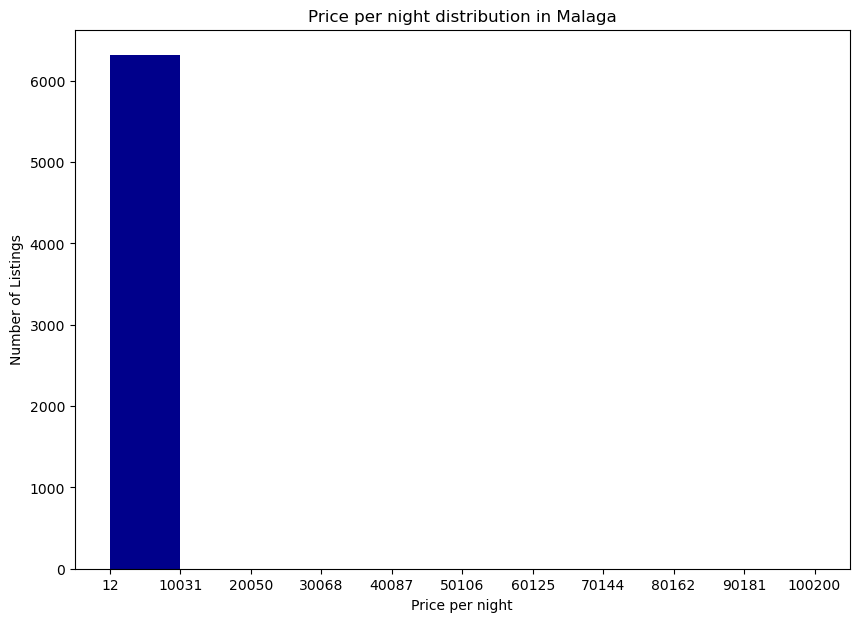

In [46]:
counts, bin_ranges_mal = np.histogram(listings_mal['price'])

listings_mal['price'].plot(kind = 'hist', figsize=(10,7), xticks=bin_ranges_mal,color ='darkblue')
plt.title('Price per night distribution in Malaga')
plt.ylabel('Number of Listings')
plt.xlabel('Price per night')
plt.show()


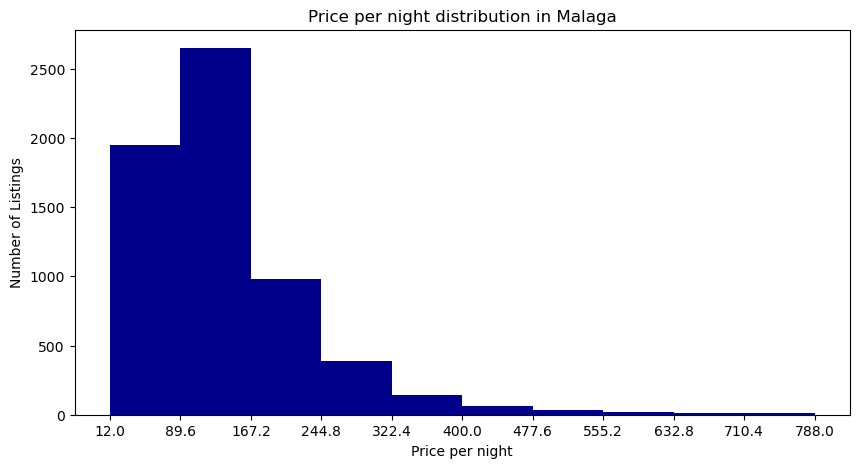

In [47]:
#Let's plot again for rooms up to 800 EUR, because again some outliers are spoiling the result.

condition = listings_mal['price'] < 800
lowlistings_mal = listings_mal[condition]

counts, bin_ranges_mal = np.histogram(lowlistings_mal['price'])

lowlistings_mal['price'].plot(kind = 'hist', figsize=(10,5), xticks=bin_ranges_mal, color = 'darkblue')

plt.title('Price per night distribution in Malaga')
plt.ylabel('Number of Listings')
plt.xlabel('Price per night')
plt.show()


The most rooms are on range **12-167.2 EUR** , especially on **89.6-167.2 EUR**


Let's now plot mean prices per neighbourhood on Malaga's map.

In [48]:
hoodprices_mal = lowlistings_mal.groupby('neighbourhood')['price'].mean()

In [49]:
malaga_map = folium.Map(location=malaga_coords, zoom_start=12)

folium.Choropleth(
    geo_data=hoods_mal,
    data=hoodprices_mal,
    #columns=['neighbourhood', 'count'],
    key_on='feature.properties.neighbourhood',
    bins=100, 
    fill_color='Greens',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Mean Prices per Neighbourhood',
    line_color="#0000",
    show=True,
    overlay=True,
    nan_fill_color = "White"
).add_to(malaga_map)

malaga_map

It seems that in Malaga, Rooms tend to be **more expensive** in **West and North-West of the city**. An expensive neighbourhood again as Seville was the Airport's neighbourhood.


Let's now check how the listings are distributed by each room type using a pie.

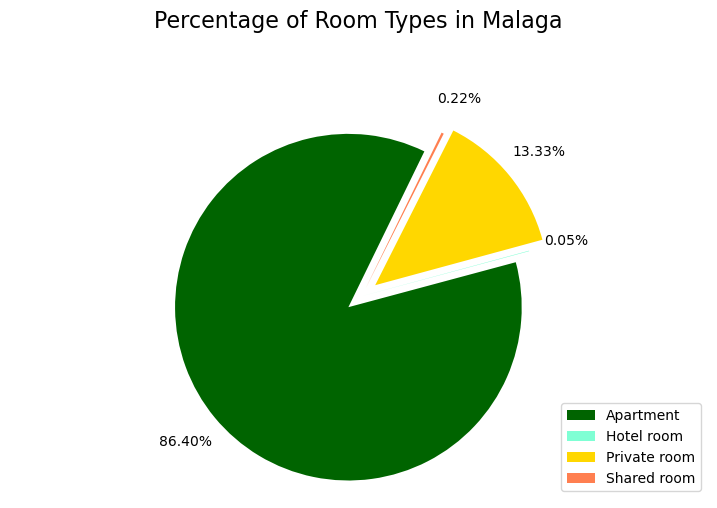

In [50]:
roomtype_counts_mal = listings_mal.groupby('room_type').size()
explode = [0.1, 0, 0.1, 0.05]
colors = ['darkgreen','aquamarine','gold','coral']
roomtype_counts_mal.plot(
    kind= 'pie',
    figsize=(9, 5),
    autopct='%1.2f%%',
    startangle=64,
    labels = None,
    pctdistance=1.22,
    explode = explode,
    colors = colors
)
plt.title('Percentage of Room Types in Malaga', y=1.2, fontsize= 16)

plt.axis('equal') 

plt.ylabel("")

plt.legend(labels = roomtype_counts_mal.index, loc='lower right' )

plt.show()

Again the **Apartments are dominant, with Private Rooms following**. Hotel and Shared Rooms are very low on quantity.

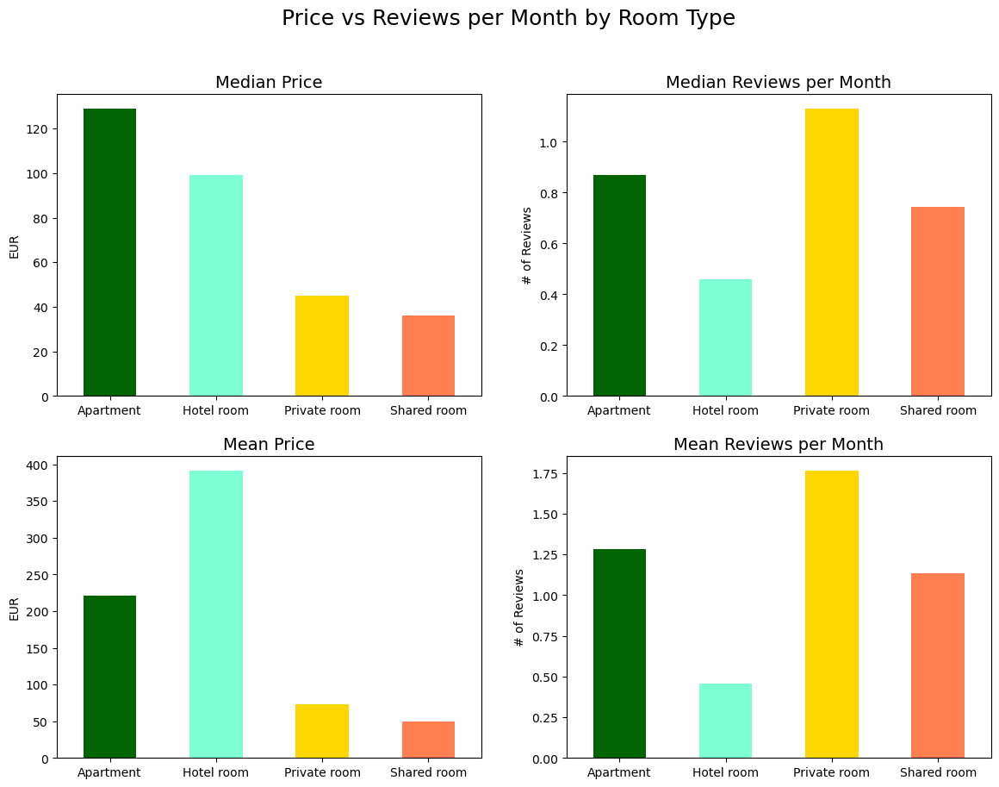

In [51]:
fig,axes = plt.subplots(2, 2, figsize=(14, 10))
fig.suptitle('Price vs Reviews per Month by Room Type', fontsize= 18)


#Let's create a variable to save the median of every room type
roomtype_medians_mal = listings_mal.groupby('room_type').median()

#And create 1 barplot to plot the median prices
roomtype_medians_mal['price'].plot(kind= 'bar',color = colors,rot= 0,ax=axes[0,0])
axes[0,0].set_title('Median Price', fontsize= 14)
axes[0,0].set_xlabel(None)
axes[0,0].set_ylabel('EUR')

#Create a barplot, to plot the median number of reviews
roomtype_medians_mal['reviews_per_month'].plot(kind= 'bar',color = colors,rot= 0,ax=axes[0,1])
axes[0,1].set_title('Median Reviews per Month', fontsize= 14)
axes[0,1].set_xlabel(None)
axes[0,1].set_ylabel('# of Reviews')

#Create a variable to save the mean of every room type
roomtype_means_mal = listings_mal.groupby('room_type').mean()

#Create a barplot to plot the mean prices
roomtype_means_mal['price'].plot(kind= 'bar',color = colors,rot= 0,ax=axes[1,0])
axes[1,0].set_title('Mean Price', fontsize= 14)
axes[1,0].set_xlabel(None)
axes[1,0].set_ylabel('EUR')

#Lastly, create a barplot to plot the mean number of reviews
roomtype_means_mal['reviews_per_month'].plot(kind= 'bar',color = colors,rot= 0,ax=axes[1,1])
axes[1,1].set_title('Mean Reviews per Month', fontsize= 14)
axes[1,1].set_xlabel(None)
axes[1,1].set_ylabel('# of Reviews')
plt.show()

1. On **Median Prices**, **Apartments** are the **most expensive**
2. On **Mean Prices**, **Hotel Rooms** are the **most expensive** by far. This means that there are some extremely expensive hotel rooms listed in AIRBNB that shift that mean upwards.
3. **Private Rooms are dominant on monthly reviews**. This could happen due to the fact that **Median Private Room is about 80 EUR cheaper than Median Apartment**, something that possibly attracts more clients and reviewers. Also, the tourist that searches for the cheapest rooms to rent, probably stays for a few nights to have cheaper vacation, so this could mean that more tourists can rent the room and consequently review it within a month. We will now check if there is correlation between price and reviews per month using a scatter plot.

**We will plot the lower prices only, in order not to include outliers**

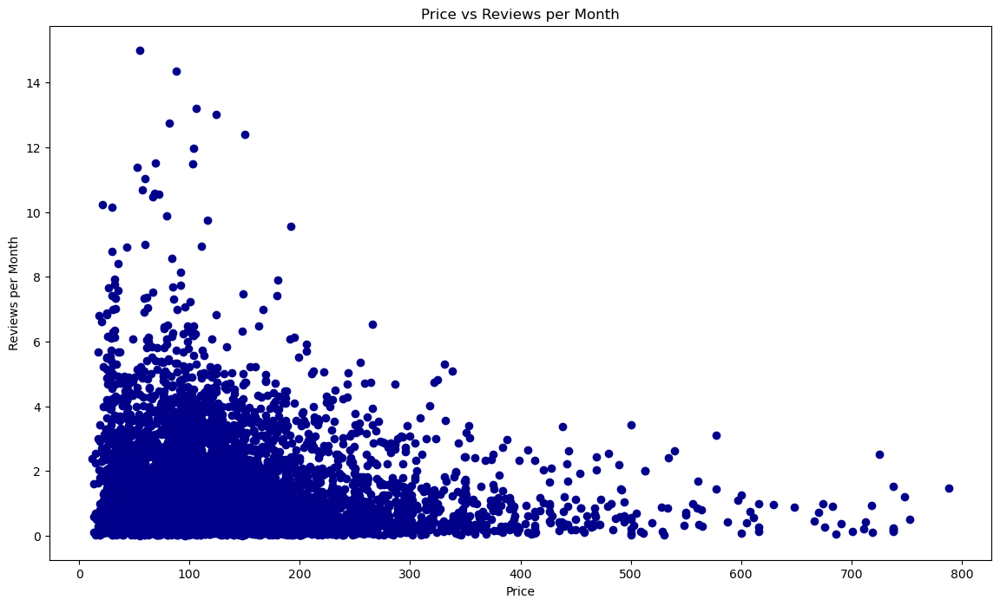

In [52]:
plt.figure(figsize=(14,8))
plt.scatter(x= lowlistings_mal['price'], y = lowlistings_mal['reviews_per_month'],color = 'darkblue')
plt.title('Price vs Reviews per Month')
plt.xlabel('Price')
plt.ylabel('Reviews per Month')
plt.show()

It is now clear that **the cheaper the room is, the more reviews per month will get**. So **it is confirmed that one of the main reasons that Private Rooms get more Reviews per Month than Apartments is the lower prices.** Shared rooms, the ones that have the cheapest rooms, don't have the most reviews per month, due to the fact that possibly most of the people prefer to pay a little more to have some privacy.

Let's now check the top 100 apartments or private rooms by reviews per month in Malaga.

In [53]:
condition = (listings_mal['room_type'] == 'Apartment') | (listings_mal['room_type'] == 'Private room')

top100_mal = listings_mal[condition].sort_values(by=['reviews_per_month'],ascending= False).head(100)
top100_mal.head()

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
6899,803563398956005387,Apartamento muy soleado,495869443,Toñi,Teatinos-Universidad,36.721124,-4.457497,Apartment,55,1,35,2023-03-28,15.00,1,42,35,Exempt
6906,804875288090643324,Azahar studio 7 min from the beach Parking at ...,49010299,Marwane Henri,Carretera de Cadiz,36.706516,-4.437390,Apartment,88,1,33,2023-03-30,14.35,3,158,33,VFT/MA/47875
4047,50524258,Apartamento(2)-Centro Málaga a 0’9km+ParkingGr...,226466430,Rafa&Pilu,Bailen-Miraflores,36.723680,-4.435250,Apartment,106,1,280,2023-03-20,13.19,3,192,170,VFT/MA/45312
1985,30141259,Apartamento Centro Málaga+Garaje Privado Gratis,226466430,Rafa&Pilu,Centro,36.722300,-4.427160,Apartment,124,1,672,2023-03-23,13.01,3,275,182,CTC-2018210640
6902,804293923406034179,Medina studio 7 min from the beach Parking at ...,49010299,Marwane Henri,Carretera de Cadiz,36.706516,-4.437390,Apartment,82,1,31,2023-03-30,12.74,3,206,31,VFT/MA/47875


In [54]:
malaga_map = folium.Map(location=malaga_coords, zoom_start=12)
rooms = folium.map.FeatureGroup()

for lat,lng,name,price in zip(top100_mal.latitude, top100_mal.longitude, top100_mal.name,top100_mal.price):
    folium.Marker(
        location= [lat,lng],
        popup= (name,price),
         icon=folium.Icon(color='darkblue', icon="fa-home", prefix='fa')
    ).add_to(rooms)


malaga_map.add_child(rooms)

In [55]:
top100_mal.set_index('id', inplace= True)

**Almost all of them are very close to the city center as expected.**

In [56]:
#Load the calendar.csv for Malaga too.
calendar_mal = pd.read_csv('Malaga/calendar.csv')
calendar_mal

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights
0,2138517,2023-04-01,f,$85.00,$85.00,4,10
1,2138517,2023-04-02,f,$85.00,$85.00,4,10
2,2138517,2023-04-03,f,$85.00,$85.00,4,10
3,2138517,2023-04-04,f,$85.00,$85.00,4,10
4,2138517,2023-04-05,f,$85.00,$85.00,4,10
...,...,...,...,...,...,...,...
2749821,4123068,2024-03-26,f,$351.00,$351.00,7,40
2749822,4123068,2024-03-27,f,$351.00,$351.00,7,40
2749823,4123068,2024-03-28,f,$351.00,$351.00,7,40
2749824,4123068,2024-03-29,f,$351.00,$351.00,7,40


Make the necessary changes on the data types.

In [57]:
calendar_mal['date'] = pd.to_datetime(calendar_mal['date']) #date to datetime
calendar_mal['available'] = calendar_mal['available'].replace({'f': False, 't': True})
calendar_mal['price'] = calendar_mal['price'].str.replace('$','').str.replace(',', '').astype(str)
calendar_mal['price'] = calendar_mal['price'].astype(float)
calendar_mal['adjusted_price'] = calendar_mal['adjusted_price'].str.replace('$','').str.replace(',', '').astype(str)
calendar_mal['adjusted_price'] = calendar_mal['adjusted_price'].astype(float)
calendar_mal.dtypes

listing_id                 int64
date              datetime64[ns]
available                   bool
price                    float64
adjusted_price           float64
minimum_nights             int64
maximum_nights             int64
dtype: object

Now let's plot the mean price for the next 100 days in these top 100 rooms.

In [58]:

condition = calendar_mal['listing_id'].isin(top100_mal.index)
cal_top100_mal = calendar_mal[condition]

mean_prices_mal = cal_top100_mal.groupby('date')['price'].mean()

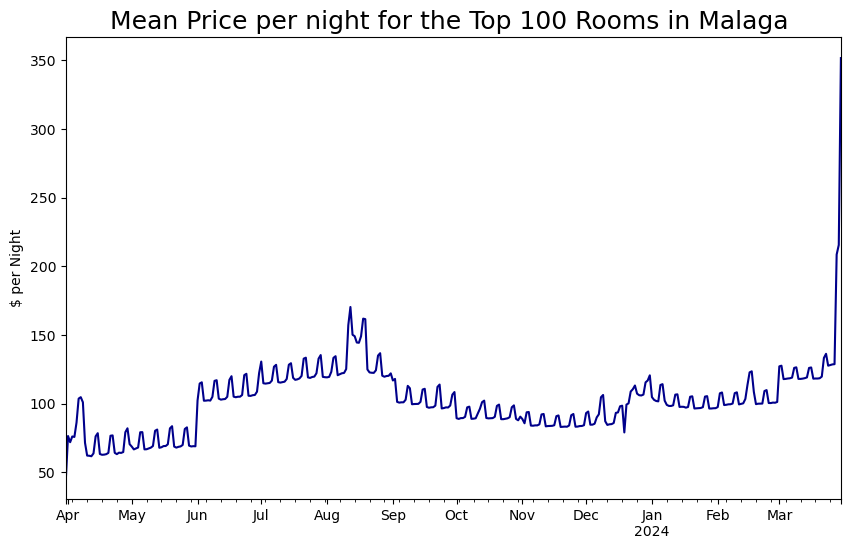

In [59]:
plt.figure(figsize=(10,6))

mean_prices_mal.plot(color = 'darkblue')

plt.title('Mean Price per night for the Top 100 Rooms in Malaga ', fontsize = 18)
plt.xlabel(None)
plt.ylabel('$ per Night')

plt.show()

1. There is an **upward trend until Mid-August** where there is a top. That's normal if we think of that Malaga is more like a summer destination because of the coast.
2. The price **pumps** on **early June** indicating the start of the summer season.
3. Price **drops from Late August to near Christmas**.
4. Seasonality- **Highs on Weekends**


Now let's check the availability through time.

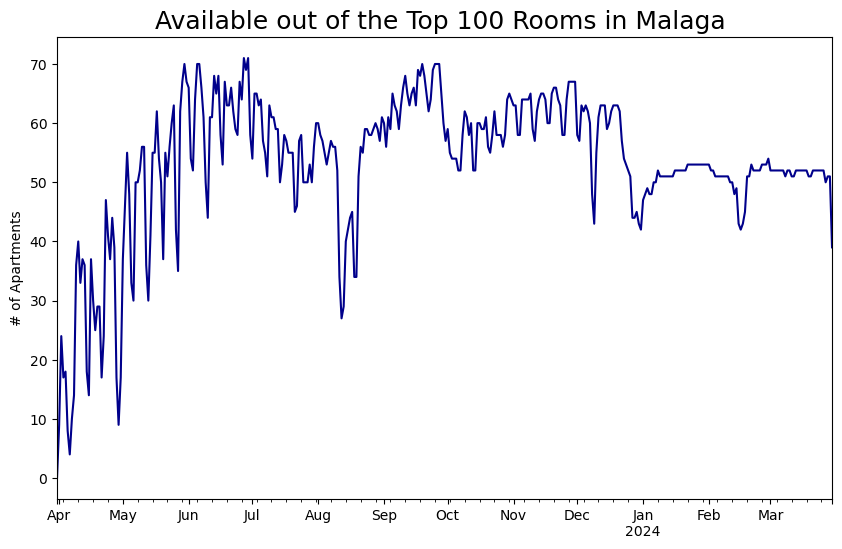

In [60]:
availables_mal = cal_top100_mal.groupby('date')['available'].sum()

plt.figure(figsize=(10,6))

availables_mal.plot(color = 'darkblue')
plt.title('Available out of the Top 100 Rooms in Malaga ', fontsize = 18)
plt.xlabel(None)
plt.ylabel('# of Apartments')
plt.show()

Let's now check the availability of the top 100 Apartments vs the availability of the top 100 Private Rooms seperately.

<Figure size 1000x600 with 0 Axes>

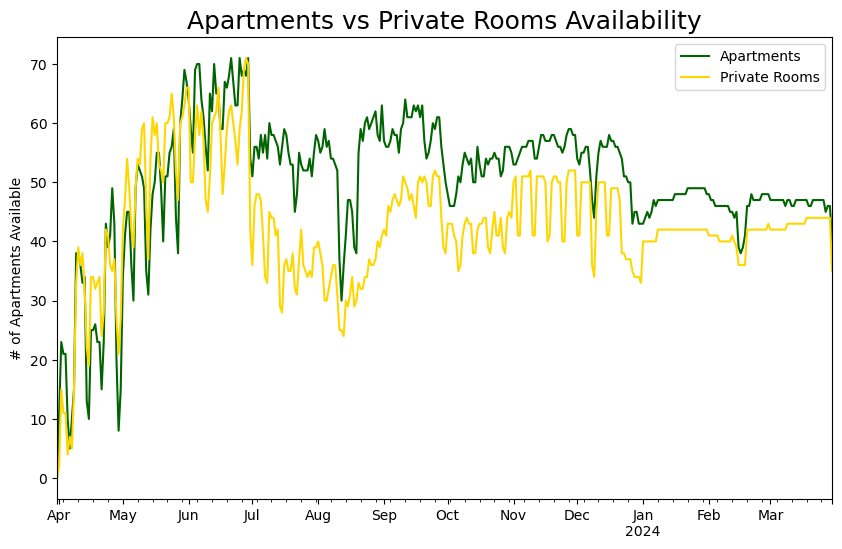

In [61]:
#Top 100 Apartments :
condition = listings_mal['room_type'] == 'Apartment'
apart100 = listings_mal[condition].sort_values(by=['reviews_per_month'],ascending= False).head(100)
apart100.set_index('id', inplace= True)

#Top 100 Private Rooms:
condition = listings_mal['room_type'] == 'Private room'
prive100 = listings_mal[condition].sort_values(by=['reviews_per_month'],ascending= False).head(100)
prive100.set_index('id', inplace= True)

#Calendar of Top 100 Apartments:
condition = calendar_mal['listing_id'].isin(apart100.index)
cal_apart100 = calendar_mal[condition]

#Calendar of Top 100 Private Rooms:
condition = calendar_mal['listing_id'].isin(prive100.index)
cal_prive100 = calendar_mal[condition]

#Sum of every category

availables_apart = cal_apart100.groupby('date')['available'].sum()
availables_prive = cal_prive100.groupby('date')['available'].sum()
plt.figure(figsize=(10,6))

#Plot

plt.figure(figsize=(10,6))

availables_apart.plot(color = 'darkgreen')
availables_prive.plot(color = 'gold')
plt.title('Apartments vs Private Rooms Availability', fontsize = 18)
plt.xlabel(None)
plt.ylabel('# of Apartments Available')
plt.legend(labels = ['Apartments','Private Rooms'])
plt.show()


1. Consant **upward trend till mid-June.**
2. **Massive drop** from **mid-June to mid-August**. Probably booked early for the summer vacation.
3. **Until mid-June the Apartments and Private Rooms have pretty much the same availabilty** and f**rom the start of the season private rooms are always lower than apartments**. If we think about it, we know that Apartments are much more expensive than Private rooms on mean or median terms, so people that don't care about the price so much don't have any reason to book their holiday already in April. People who wants to cheaply rent a room are in a hurry to catch the low prices. The only period in the summer that Apartments and private rooms have pretty much the same availabilty is on **mid-August** where everybody knows that in this period the demand for rooms will be very high, so in this case even richer people seem to hurry up.

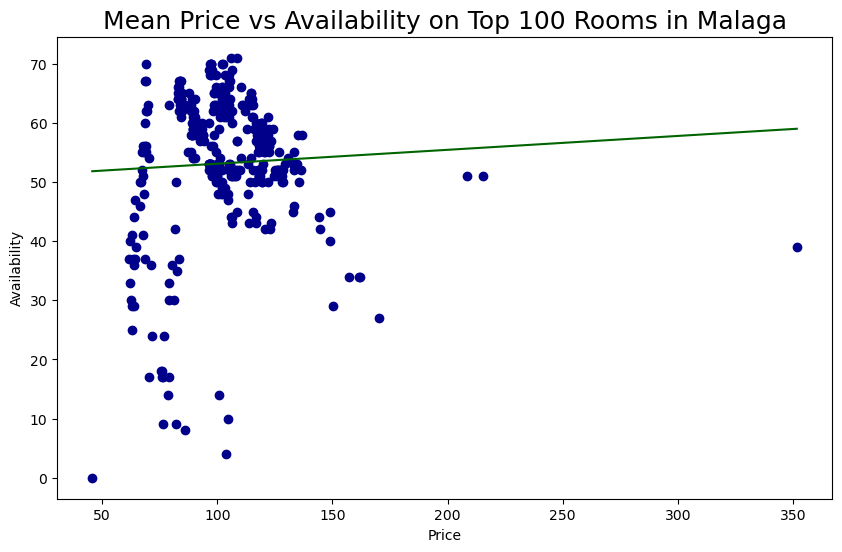

In [62]:
x = mean_prices_mal.values
y = availables_mal.values
polynomial_mal = Polynomial.fit(x, y, deg=1)
plt.figure(figsize=(10,6))
plt.scatter(mean_prices_mal.values, availables_mal.values, color = 'darkblue')
plt.title('Mean Price vs Availability on Top 100 Rooms in Malaga', fontsize = 18)
plt.xlabel('Price')
plt.ylabel('Availability')
plt.plot(x, polynomial_mal(x), color='darkgreen')


plt.show()

This scatter plot indicates that there is **no correlation between mean price and availability.**

Lastly, let's check how centralized is this AIRBNB economy.

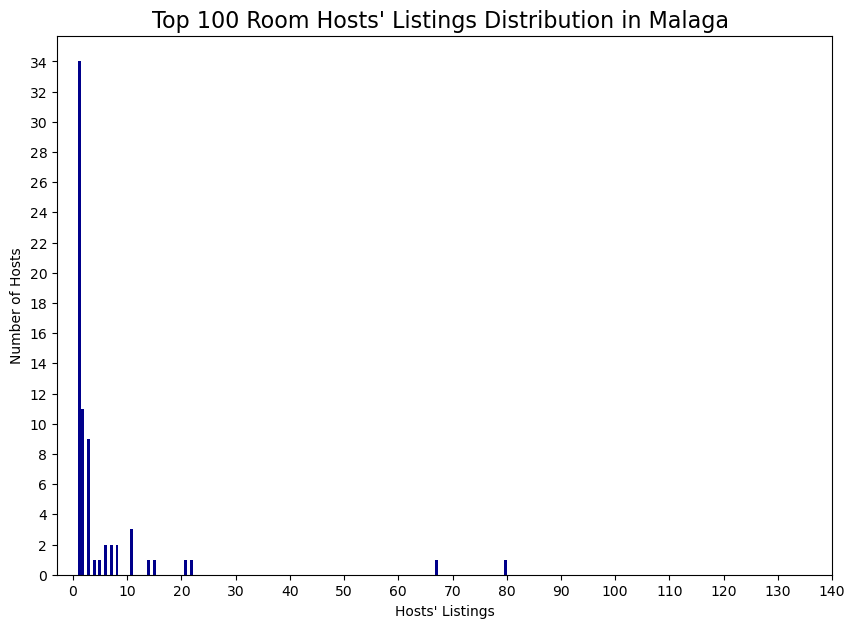

In [63]:
top100_mal.groupby('host_id')['calculated_host_listings_count'].mean().plot(kind = 'hist', figsize=(10,7), color = 'darkblue', bins = 150,xticks= range(0,150,10),yticks=range(0,36,2))
plt.title("Top 100 Room Hosts' Listings Distribution in Malaga ", fontsize = 16)
plt.ylabel('Number of Hosts')
plt.xlabel("Hosts' Listings")
plt.show()

It is clear that most of these top 100 rooms hosts have **up to 3 listings** in AIRBNB which indicates that **Malaga's AIRBNB economy is** pretty much **distributed**. 

# Seville vs Malaga Comparison

**In this last part of the project, we will compare these 2 cities based on our Visual Analysis.**

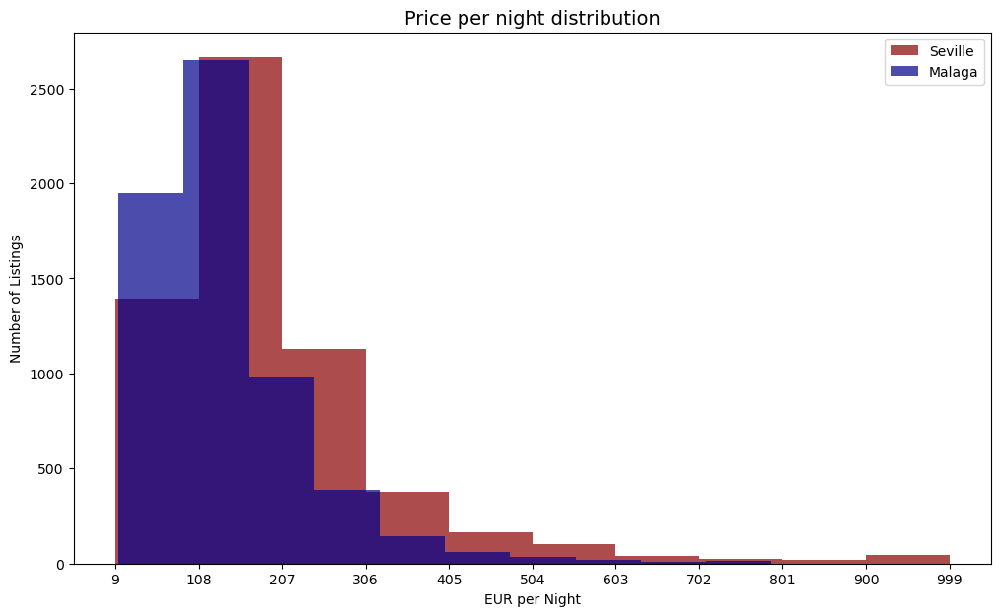

In [64]:
plt.figure(figsize=(12, 7))

lowlistings['price'].plot(kind = 'hist', xticks=bin_ranges_sev, color = 'darkred', alpha = 0.7)
lowlistings_mal['price'].plot(kind = 'hist', xticks=bin_ranges_sev, color = 'darkblue', alpha = 0.7)

plt.xlabel('EUR per Night')
plt.ylabel('Number of Listings')
plt.title('Price per night distribution', fontsize= 14)
plt.legend(labels = ['Seville','Malaga'])
plt.show()

From these 2 plots we can understand that **Malaga** tends to offer **cheaper** rooms than Seville.

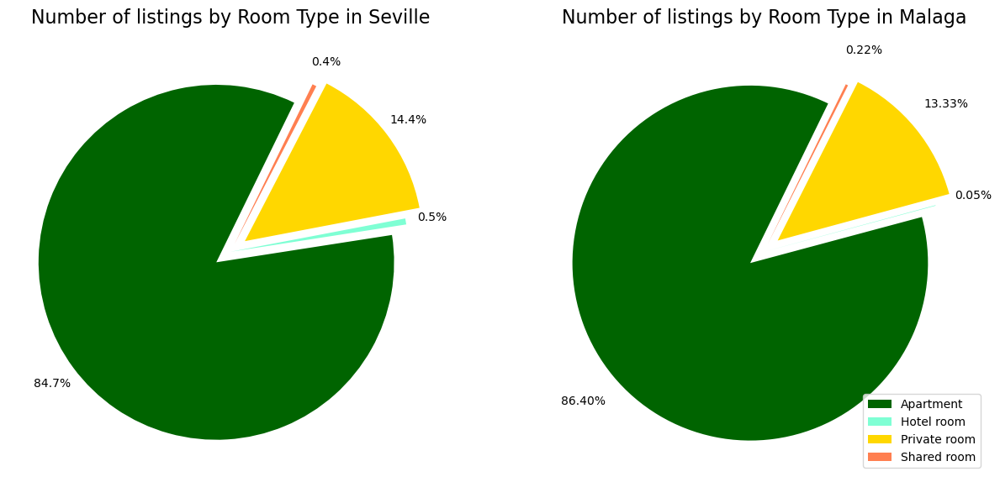

In [65]:
fig, axes = plt.subplots(1,2, figsize= (15,9))

explode = [0.1, 0, 0.1, 0.05]
roomtype_counts.plot(
    kind= 'pie',
    autopct='%1.1f%%',
    startangle=64,
    labels = None,
    pctdistance=1.15,
    explode = explode,
    colors = colors,
    ax= axes[0]
)
axes[0].set_title('Number of listings by Room Type in Seville', fontsize= 16)
axes[0].set_ylabel("")

#axes[0].legend(labels = roomtype_counts.index, loc='lower right' )
explode1 = [0.1, 0, 0.1, 0.05]
roomtype_counts_mal.plot(
    kind= 'pie',
    autopct='%1.2f%%',
    startangle=64,
    labels = None,
    pctdistance=1.22,
    explode = explode1,
    colors = colors,
    ax =axes[1]
)
axes[1].set_title('Number of listings by Room Type in Malaga', fontsize= 16)
axes[1].set_ylabel("")

plt.legend(labels = roomtype_counts_mal.index, loc='lower right' )

plt.show()

**Room Types are pretty much the same in both cities.**

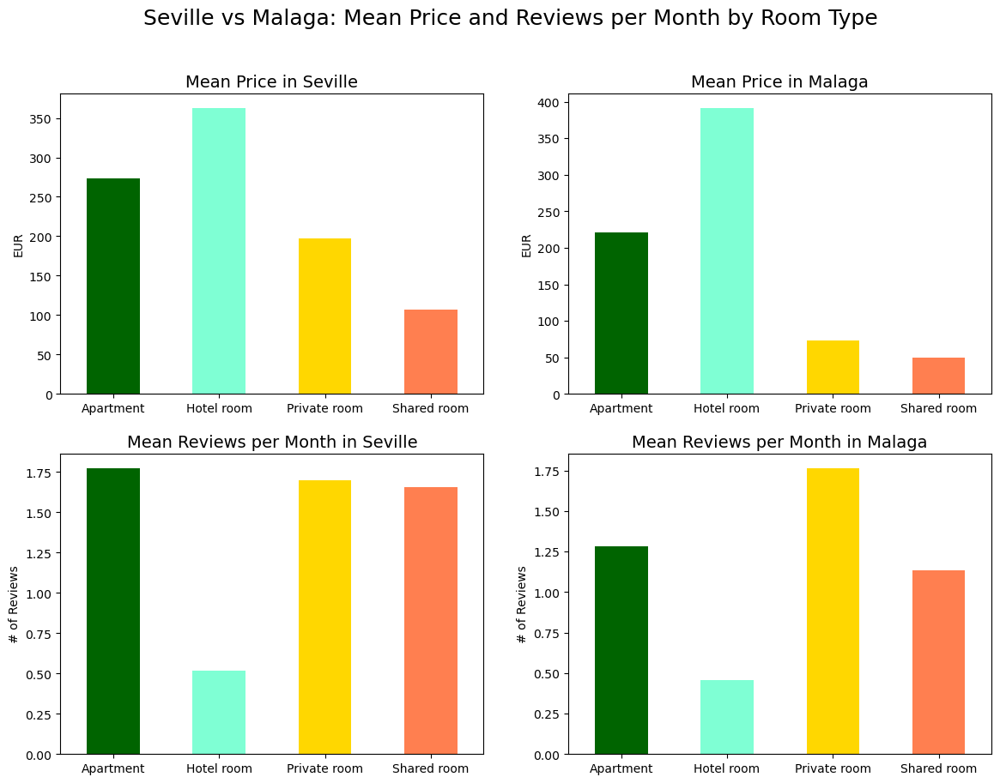

In [66]:
fig,axes = plt.subplots(2, 2, figsize=(14, 10))
fig.suptitle('Seville vs Malaga: Mean Price and Reviews per Month by Room Type', fontsize= 18)

roomtype_means['price'].plot(kind= 'bar',color = colors,rot= 0,ax=axes[0,0])
axes[0,0].set_title('Mean Price in Seville', fontsize= 14)
axes[0,0].set_xlabel(None)
axes[0,0].set_ylabel('EUR')

roomtype_means_mal['price'].plot(kind= 'bar',color = colors,rot= 0,ax=axes[0,1])
axes[0,1].set_title('Mean Price in Malaga', fontsize= 14)
axes[0,1].set_xlabel(None)
axes[0,1].set_ylabel('EUR')

roomtype_means['reviews_per_month'].plot(kind= 'bar',color = colors,rot= 0,ax=axes[1,0])
axes[1,0].set_title('Mean Reviews per Month in Seville', fontsize= 14)
axes[1,0].set_xlabel(None)
axes[1,0].set_ylabel('# of Reviews')

roomtype_means_mal['reviews_per_month'].plot(kind= 'bar',color = colors,rot= 0,ax=axes[1,1])
axes[1,1].set_title('Mean Reviews per Month in Malaga', fontsize= 14)
axes[1,1].set_xlabel(None)
axes[1,1].set_ylabel('# of Reviews')

plt.show()

1. **Hotel Rooms** are by far the **most expensive** in both cities
2. **Mean Prices in Malaga** are **lower** in every category except hotel rooms
3. **All** the room types except hotel rooms are **above 1.50** mean monthly  reviews **in Seville**, but **only Private room in Malaga**
4. By mean terms, **Seville** tends to have **more reviews per month** than Malaga.

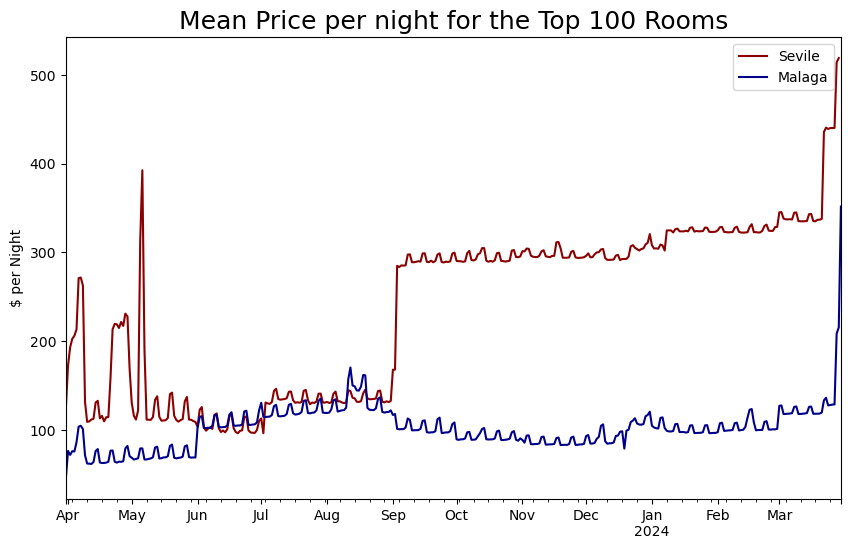

In [67]:
plt.figure(figsize=(10,6))
mean_prices_sev.plot(color = 'darkred')
mean_prices_mal.plot(color = 'darkblue')

plt.title('Mean Price per night for the Top 100 Rooms', fontsize = 18)
plt.xlabel(None)
plt.ylabel('$ per Night')
plt.legend(labels= ['Sevile','Malaga'])

plt.show()

1. In **near future** the prices in **Malaga** are **lower** than the prices in Seville. Also, in this period **the variance of mean price is higher in Seville**.
2. In **summer months** the prices are pretty much **equal** and in **mid-August** prices in **Malaga** even get **higher** than Seville!
3. From **September and after** the prices in **Seville** **explode**, probably due to the fact of the lower supply as we said before.

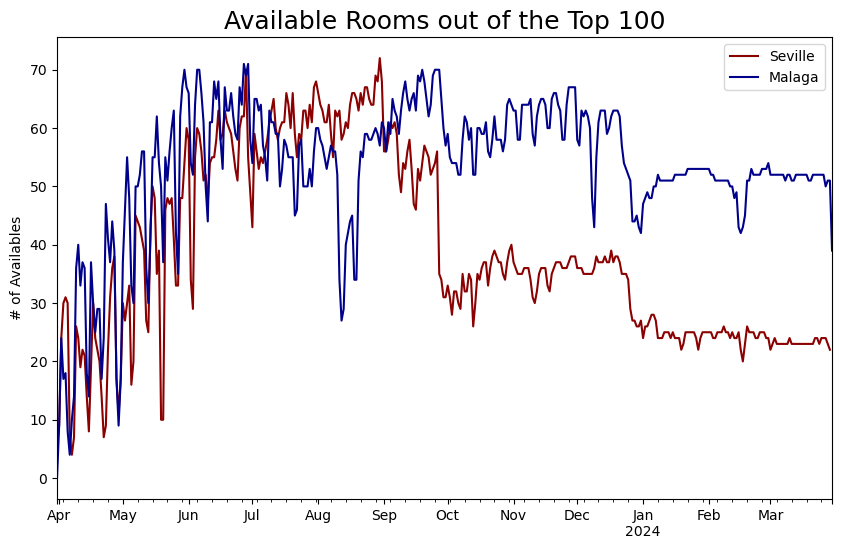

In [68]:
plt.figure(figsize=(10,6))
availables_sev.plot(color = 'darkred')
availables_mal.plot(color = 'darkblue')

plt.title('Available Rooms out of the Top 100', fontsize = 18)
plt.xlabel(None)
plt.ylabel('# of Availables')
plt.legend(labels= ['Seville','Malaga'])

plt.show()

This plot shows again how much in the **summer-time** **Malaga Rooms are booked over Seville Rooms**. **After the summer**, availability in **Seville** has 2 **big drops** but Malaga doesn't have that big.

Let's compare Apartments and Private Rooms' Availability in each city.

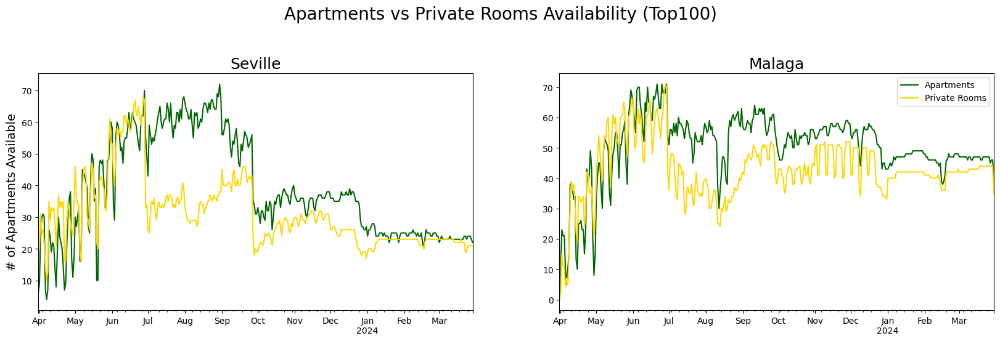

In [69]:
fig,axes = plt.subplots(1, 2, figsize=(20, 5))
fig.suptitle('Apartments vs Private Rooms Availability (Top100)',y=1.1, fontsize= 20)

availables_apart_sev.plot(color = 'darkgreen',ax= axes[0])
availables_prive_sev.plot(color = 'gold',ax= axes[0])
axes[0].set_title('Seville', fontsize = 18)
axes[0].set_xlabel(None)
axes[0].set_ylabel('# of Apartments Available',fontsize= 14)

availables_apart.plot(color = 'darkgreen',ax= axes[1])
availables_prive.plot(color = 'gold',ax= axes[1])
axes[1].set_title('Malaga', fontsize = 18)
axes[1].set_xlabel(None)
axes[1].set_ylabel(None)
plt.legend(labels = ['Apartments','Private Rooms'])
plt.show()

1. **Malaga doesn't have** these **massive drops** that Seville has.
2. **Malaga's availablity** finds a **bottom in mid-August** which is very high season possibly because it is located on the coast, and then recovers pos
3. **Seville's rooms** from September and after are **constantly getting withdrawned from the market**,while in Malaga this phenomenon doesn't appear. 

**From the last 3 plots we can understand that Malaga's tourism is more seasonal than Seville's. Seville tends to have a better balance all over the year, but Malaga's tourism clearly tops in mid-August in terms of room availability and price per night.**

Lastly, let's compare the centralization of the AIRBNB economy in each city, by checking the distribution of these top 100 rooms hosts total listings in AIRBNB.

In [70]:
sev_owners = top100['host_id'].nunique()
mal_owners = top100_mal['host_id'].nunique()

print(f'Top 100 Seville Rooms are owned by {sev_owners} unique hosts.')
print(f'Top 100 Malaga Rooms are owned by {mal_owners} unique hosts.')

Top 100 Seville Rooms are owned by 78 unique hosts.
Top 100 Malaga Rooms are owned by 71 unique hosts.


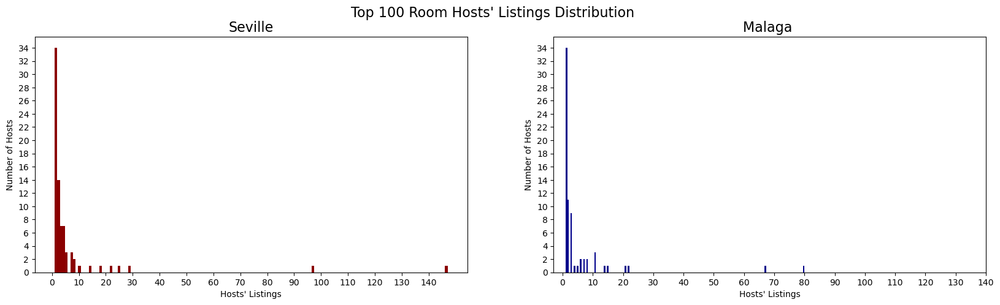

In [71]:
fig,axes = plt.subplots(1,2,figsize=(20, 5))
plt.suptitle("Top 100 Room Hosts' Listings Distribution ", fontsize = 16)

top100.groupby('host_id')['calculated_host_listings_count'].mean().plot(kind = 'hist', color = 'darkred', bins = 150,xticks= range(0,150,10),yticks=range(0,36,2),ax= axes[0])
axes[0].set_title("Seville", fontsize = 16)
axes[0].set_ylabel('Number of Hosts')
axes[0].set_xlabel("Hosts' Listings")

top100_mal.groupby('host_id')['calculated_host_listings_count'].mean().plot(kind = 'hist', color = 'darkblue', bins = 150,xticks= range(0,150,10),yticks=range(0,36,2), ax = axes[1])
axes[1].set_title("Malaga ", fontsize = 16)
axes[1].set_ylabel('Number of Hosts')
axes[1].set_xlabel("Hosts' Listings")
plt.show()

We can understand that both **Seville and Malaga** have **distributed AIRBNB economies**. As we can see in both cities most of the top 100 room hosts have **under 5 listings** overall.This means that the most reviewed rooms are mainly owned by people who do not own a big amount of AIRBNB rooms. Also, the most 100 reviewed AIRBNBs have **over 70 different owners in each city**,so the profits are getting distributed to a lot of people and are not getting accumulated by the few.

# Conclusion

In this project we went through a **visual analysis** of some AIRBNB data of the cities of **Seville and Malaga**. We got some useful insights, such as **hotel rooms are the most expensive** and the **less reviewed rooms** or that **mean price per night and total availability has some correlation in Seville**,but **price and reviews per month are high correlated in both cities**. We compared the results and we got some conclusions, like **Malaga's mean prices are lower than Seville's except summer**, but **the rooms in Seville tend to get reviewed more than Malaga's over the year, except its Private Rooms**. Lastly, we saw that **in both cities the most 100 reviewed Apartments and Private Rooms have a big number od owners**, **78 in Seville** and **71 in Malaga**, and the most of thes owners the have **up to 5 overall listings**, which indicates that the **AIRBNB economy in these 2 cities is pretty much distributed and the profits are not getting accumulated to the few**.